In [2]:
#IMORTING NECCEASRY LIBRARIES.
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from itertools import permutations
from nltk.corpus import stopwords
import string
import re
import numpy as np
import spacy
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.base import TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.svm import LinearSVC
from sklearn.feature_extraction.stop_words import ENGLISH_STOP_WORDS
from sklearn.metrics import accuracy_score
from nltk.corpus import stopwords
import string
import re
import spacy
import pandas as pd
from spacy.lang.en import English
from sklearn.model_selection import train_test_split
import csv
import matplotlib.pyplot as plt 
parser = English()

In [3]:
#INITIALIZING STOP WORDS LIST FOR CLEANING DATA
STOPLIST = set(stopwords.words('english') + list(ENGLISH_STOP_WORDS))
SYMBOLS = " ".join(string.punctuation).split(" ") + ["-", "...", "”", "”"]
#read the data and their labels from a given file
contents=[]
reviews=[]
labels=[]

In [4]:
df= pd.read_csv("ProjectData.csv", engine ="python")

In [5]:
#del df['reviews_list']
del df['address']

In [10]:
df.head(10)

,Unnamed: 0,name,online_order,book_table,rate,Overall rating,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list
0,1,Jalsa,Yes,Yes,4.1,5,775,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ..."
1,2,Spice Elephant,Yes,No,4.1,5,787,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din..."
2,3,San Churro Cafe,Yes,No,3.8,5,918,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ..."
3,4,Addhuri Udupi Bhojana,No,No,3.7,5,88,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper..."
4,5,Grand Village,No,No,3.8,5,166,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ..."
5,6,Timepass Dinner,Yes,No,3.8,5,286,Basavanagudi,Casual Dining,"Onion Rings, Pasta, Kadhai Paneer, Salads, Sal...",North Indian,600,"[('Rated 3.0', 'RATED\n Food 3/5\nAmbience 3/..."
6,7,Rosewood International Hotel - Bar & Restaurant,No,No,3.6,5,8,Mysore Road,Casual Dining,Masala Dosa,"North Indian, South Indian, Andhra, Chinese",800,"[('Rated 5.0', 'RATED\n Awesome food ??Great ..."
7,8,Onesta,Yes,Yes,4.6,5,2556,Banashankari,"Casual Dining, Cafe","Farmhouse Pizza, Chocolate Banana, Virgin Moji...","Pizza, Cafe, Italian",600,"[('Rated 5.0', 'RATED\n I personally really l..."
8,9,Penthouse Cafe,Yes,No,4.0,5,324,Banashankari,Cafe,"Pizza, Mocktails, Coffee, Nachos, Salad, Pasta...","Cafe, Italian, Continental",700,"[('Rated 3.0', ""RATED\n I had been to this pl..."
9,10,Smacznego,Yes,No,4.2,5,504,Banashankari,Cafe,"Waffles, Pasta, Coleslaw Sandwich, Choco Waffl...","Cafe, Mexican, Italian, Momos, Beverages",550,"[('Rated 4.0', ""RATED\n Easy to locate\nVFM 3..."


In [6]:
#REMOVING NULL VALUES
if df.isnull().values.any() == True:                  #handle empty values if any in testing data
    print ("null")

In [7]:
#COMBINING RELEVANT DATA FOR MODELING
reviews = df.online_order + df.book_table + df.rest_type + df.dish_liked + df.cuisines
labels = df['location']
#print(labels)
#f.close()
print(reviews,'\t', labels)

0        YesYesCasual DiningPasta, Lunch Buffet, Masala...
1        YesNoCasual DiningMomos, Lunch Buffet, Chocola...
2        YesNoCafe, Casual DiningChurros, Cannelloni, M...
3        NoNoQuick BitesMasala DosaSouth Indian, North ...
4        NoNoCasual DiningPanipuri, Gol GappeNorth Indi...
                               ...                        
20943    NoNoBarCocktails, Beer, Pizza, Long Island Ice...
20944    YesYesPub, Casual DiningPizza, Beer, Cocktails...
20945    NoYesCasual Dining, PubPizza, BeerNorth Indian...
20946    YesYesBar, Casual DiningBeer, Chicken Guntur, ...
20947      NoNoFine Dining, BarRooftop AmbienceFinger Food
Length: 20948, dtype: object 	 0        Banashankari
1        Banashankari
2        Banashankari
3        Banashankari
4        Basavanagudi
             ...     
20943      Whitefield
20944      Whitefield
20945      Whitefield
20946      Whitefield
20947      Whitefield
Name: location, Length: 20948, dtype: object


In [8]:
#DEFINGINF TOKENIZING FUNCTION
def tokenizeText(sample):
    tokens = parser(sample)
    lemmas = []
    for tok in tokens:
        lemmas.append(tok.lemma_.lower().strip() if tok.lemma_ != "-PRON-" else tok.lower_)
    tokens = lemmas
    tokens = [tok for tok in tokens if tok not in STOPLIST]    
    tokens = [tok for tok in tokens if tok not in SYMBOLS]
    return tokens


In [9]:
#DEFINGING CLEANING TEXT FUNCTION
class CleanTextTransformer(TransformerMixin):
   def transform(self, X, **transform_params):
        return [cleanText(text) for text in X]
   def fit(self, X, y=None, **fit_params):
        return self
def get_params(self, deep=True):
        return {}
    
def cleanText(text):         #clean the text
    if type(text)==float:
        pass
    elif type(text)==int:
        pass
    elif str(text)==np.NAN:
        text="NA"
    else:
        text=str(text)
        text = text.strip().replace("\n", " ").replace("\r", " ")
        text = text.lower()
    return text

In [10]:
#PARTITIONING THE DATA
rev_train, rev_test, labels_train, labels_test = train_test_split(reviews, labels, test_size = 0.25)
#rev_train,labels_train=loadData('Train_data.txt')   #training dataset
#rev_test,labels_test=loadData('Model_Test.txt')   #testing dataset

In [11]:
#Build a counter based on the training dataset
counter = CountVectorizer(tokenizer=tokenizeText, ngram_range=(1,1))
counter.fit(rev_train)

CountVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
                lowercase=True, max_df=1.0, max_features=None, min_df=1,
                ngram_range=(1, 1), preprocessor=None, stop_words=None,
                strip_accents=None, token_pattern='(?u)\\b\\w\\w+\\b',
                tokenizer=<function tokenizeText at 0x0000024CBD7C0798>,
                vocabulary=None)

In [12]:
#count the number of times each term appears in a document and transform each doc into a count vector
counts_train = counter.transform(rev_train)#transform the training data
counts_test = counter.transform(rev_test)#transform the testing data

In [18]:
#INTIIALIZING THE SVC MODEL
model6=LinearSVC()

C:\Users\swara\Anaconda3\lib\site-packages\sklearn\svm\base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


The accuracy is: 0.9230475463051365
5222     YesNoQuick Bites, BakeryBurgers, Sandwiches, M...
10153    NoYesCasual DiningChicken Gimbap, Sushi, Beef ...
5155     YesYesCasual DiningFish, Thali, Egg Roast, But...
15907    NoNoQuick BitesMomos, Hakka Noodles, Chop Suey...
9894     YesNoQuick BitesRolls, Jumbo Chicken Roll, Fal...
                               ...                        
8407     YesYesCasual DiningSpring Roll, Vanilla Ice Cr...
8928     YesNoQuick BitesPoha, Jalebi, Paratha, Bhindi ...
16513    NoNoLoungeBeer, Cocktails, Pork Chilli, Pandi ...
1737     NoNoQuick BitesCoffee, Masala Dosa, Vada, Idli...
5103     YesNoCasual DiningButter Chicken Biryani, Gula...
Length: 5237, dtype: object
5222       Brigade Road
10153      Kammanahalli
5155     St. Marks Road
15907     Church Street
9894       Kammanahalli
              ...      
8407          Jayanagar
8928                BTM
16513      Malleshwaram
1737          Bellandur
5103             Ulsoor
Name: location, Length:

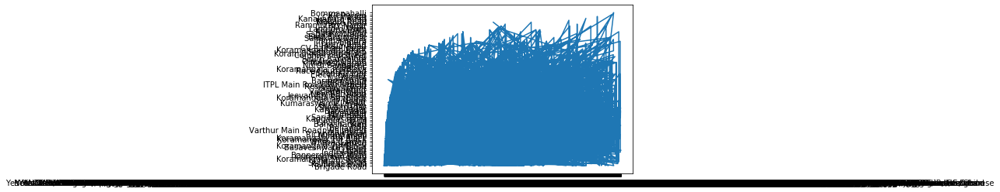

In [19]:
#SVM MODELLING 
pipe = Pipeline([('cleanText', CleanTextTransformer()), ('counter', counter), ('model6', model6)]) #sequentially apply a list of transforms and a final estimator.
pipe.fit(counts_train,labels_train)
pred6=pipe.predict(counts_test)
print ("The accuracy is:",accuracy_score(pred6,labels_test))
print(rev_test)
print(labels_test)
x1 = rev_test
x2 = labels_test
plt.plot(x1,x2)
plt.rcParams["figure.figsize"] = (20,20)
plt.show()

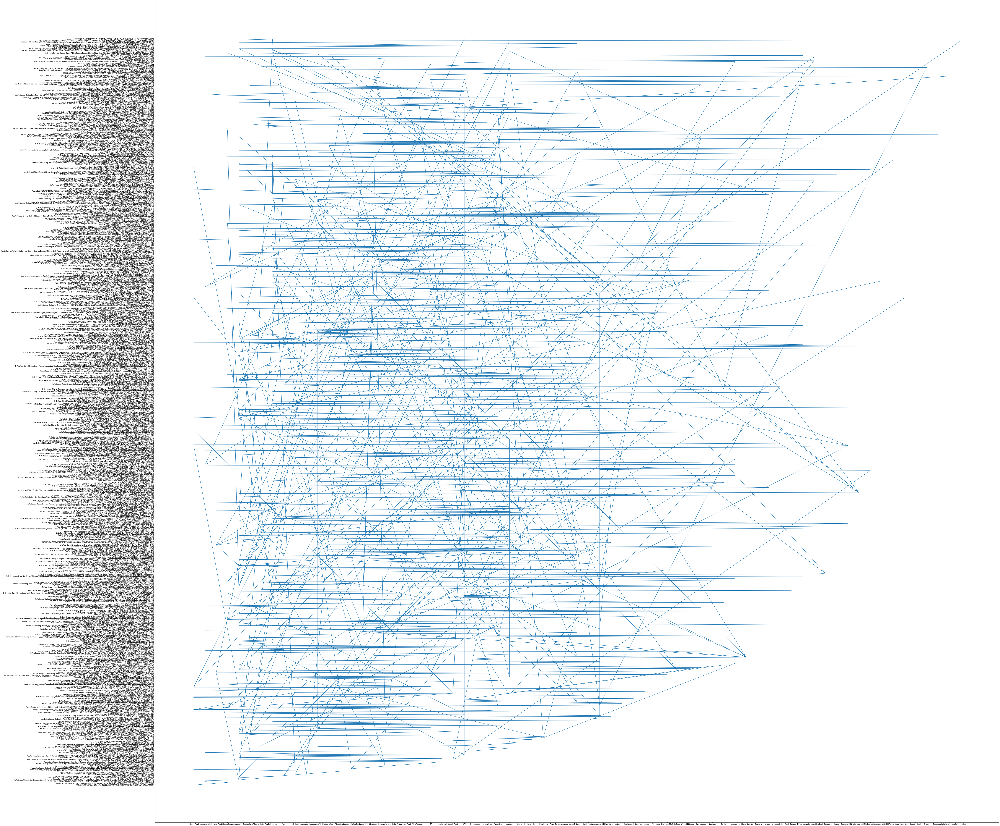

In [24]:
x11=x1.head(1000)
x22=x2.head(1000)
plt.plot(x22,x11)
plt.rcParams["figure.figsize"] = (100,100)
plt.show()

In [43]:
#INITIALIZING RANDON FOREST MODEL
model4= RandomForestClassifier(n_estimators=2500, n_jobs=-1,criterion="entropy",max_features='auto',random_state=150,max_depth=1000,min_samples_split=160 )


TypeError: 'module' object is not callable

The accuracy is: 0.6112278021768188
20224    NoNoQuick BitesParatha, Puri Sabzi, Tea, Chole...
15514    YesNoCafeSandwich, Garlic Bread, Brownie, Pota...
9906     YesNoQuick BitesParatha, Roti, Curd Rice, Thal...
11450    YesNoQuick BitesPanneer Butter MasalaNorth Indian
9433     YesNoQuick BitesVada, Butter Masala Dosa, Coff...
                               ...                        
13891    YesNoQuick BitesFish, Appam, Egg Roast, Kadala...
12945    YesNoQuick BitesFish, Appam, Egg Roast, Kadala...
1502                      YesNoDeliveryChicken CurryAndhra
266      YesYesCafeMocktails, Peri Fries, Lasagne, Pizz...
18294    YesNoCasual DiningLassi, Jeera Rice, Hariyali ...
Length: 5237, dtype: object
20224             HSR
15514    Brigade Road
9906         Nagawara
11450         Ejipura
9433     Kalyan Nagar
             ...     
13891             BTM
12945             BTM
1502        Bellandur
266      Banashankari
18294     Indiranagar
Name: location, Length: 5237, dtype: object


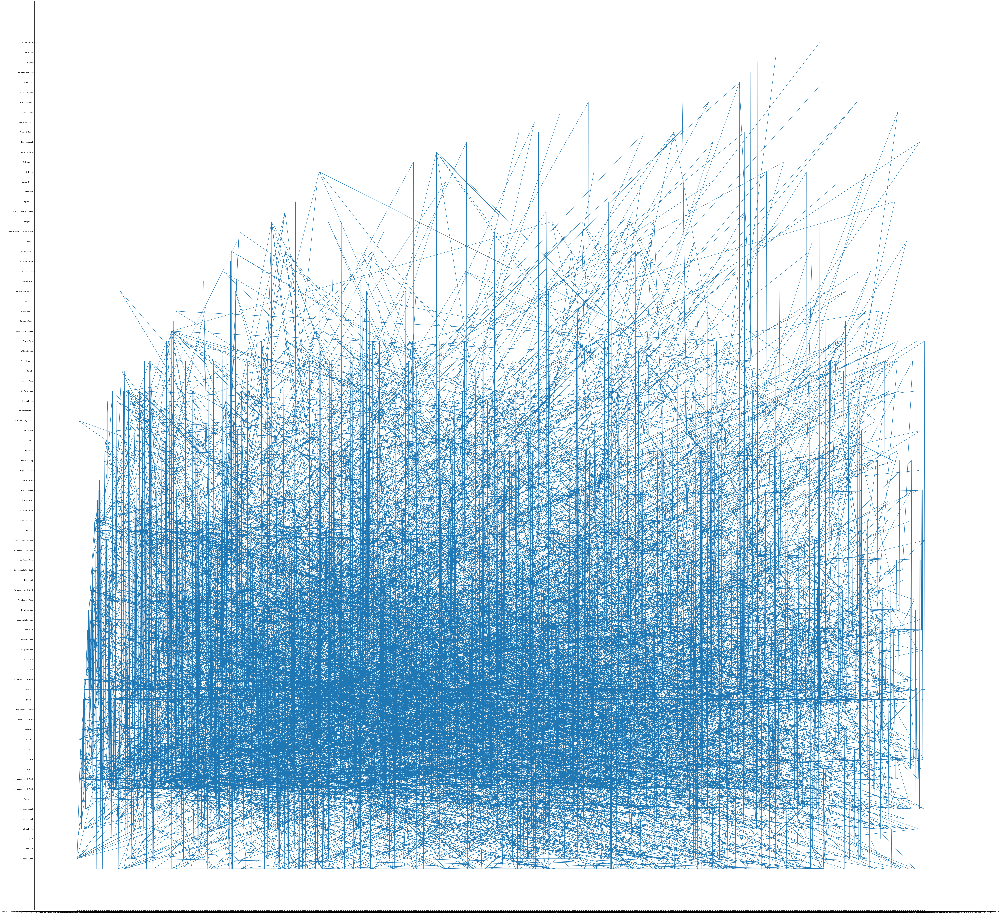

In [60]:
#HERE WE WILL RUN THE RANDOM FOREST MODEL THROUGH PIPELINE
pipe = Pipeline([('cleanText', CleanTextTransformer()), ('counter', counter), ('model4', model4)]) #sequentially apply a list of transforms and a final estimator.
pipe.fit(counts_train,labels_train)
pred6=pipe.predict(counts_test)
print ("The accuracy is:",accuracy_score(pred6,labels_test))
print(rev_test)
print(labels_test)
x1 = rev_test
x2 = labels_test
plt.plot(x1,x2)
plt.rcParams["figure.figsize"] = (20,20)

plt.show()

In [ ]:
x1 = rev_test.head(100)
x2 = labels_test.head(100)
plt.plot(x1,x2)
plt.rcParams["figure.figsize"] = (50,50)
plt.rcParams.update({'font.size': 50})
plt.show()

In [5]:
#df.location.nunique()

87

In [21]:
#df1=df.location.drop_duplicates()

In [22]:
#df1.head()

0           Banashankari
4           Basavanagudi
6            Mysore Road
31             Jayanagar
39    Kumaraswamy Layout
Name: location, dtype: object

In [23]:
#len(df1)

87

In [14]:
#HERE WE ARE IMPORTING NECCEASRY LIBRARIES FOR XGBOOST MODELLING
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
from xgboost.sklearn import XGBRegressor

model3=XGBClassifier()


In [ ]:
#XGBOOST MODEL
pipe = Pipeline([('cleanText', CleanTextTransformer()), ('counter', counter), ('model3', model3)]) #sequentially apply a list of transforms and a final estimator.
pipe.fit(counts_train,labels_train)
pred6=pipe.predict(counts_test)
print ("The accuracy is:",accuracy_score(pred6,labels_test))
print(rev_test)
print(labels_test)
x1 = rev_test
x2 = labels_test
plt.plot(x1,x2)
plt.rcParams["figure.figsize"] = (20,20)

plt.show()

The accuracy is: 0.8296734771815926
3698     YesNoQuick BitesTortilla Chips, Tabasco Pizza,...
9623     NoNoCasual DiningShawarma, Mutton Biryani, Ang...
4582     YesNoCafeBurgers, Sandwiches, Fries, Pasta, Te...
16529    YesYesBar, Casual DiningPeri Peri Chicken, Bee...
3879     NoNoCafeBurgers, Pasta, Hot Chocolate, Caramel...
                               ...                        
17256    YesNoLoungePaneer Biryani, Cocktails, Mocktail...
18274      YesNoDeliveryBiryani, Gulab Jamun, RaitaBiryani
13453    YesNoCasual DiningPizza, Pasta, Mocktails, Tir...
11738    YesNoCasual DiningAndhra Thali, Chicken Lollip...
1176     YesNoDessert ParlorChocolava, Burgers, Chocola...
Length: 5237, dtype: object
3698             JP Nagar
9623           HBR Layout
4582         Brigade Road
16529        Malleshwaram
3879                  BTM
               ...       
17256       Church Street
18274    Old Airport Road
13453              Domlur
11738                 HSR
1176            Jayanagar
N

In [ ]:
#Location as target and implementing Ml on numeric data.........................................................

In [1]:
#Loding all Libraries
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import r2_score
from matplotlib.pyplot import *
from matplotlib import pyplot as plt 

In [3]:
#Loding Data set
data = pd.read_csv("ProjectData.csv", encoding = "ISO-8859-1")

In [ ]:
data.info()

In [ ]:
new_data = data.drop(columns = ['Unnamed: 0', 'reviews_list', 'Overall rating'], axis=1)
new_data.columns

In [ ]:
new_data

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
le = LabelEncoder()

In [ ]:
#One hot encoding
new_data.location = le.fit_transform(new_data.location)
new_data.address = le.fit_transform(new_data.address)
new_data.name = le.fit_transform(new_data.name)
new_data.online_order = le.fit_transform(new_data.online_order)
new_data.book_table = le.fit_transform(new_data.book_table)
new_data.rest_type = le.fit_transform(new_data.rest_type)
new_data.dish_liked = le.fit_transform(new_data.dish_liked)
new_data.cuisines = le.fit_transform(new_data.cuisines)

In [ ]:
#Correlation methon
corr = new_data.corr(method='kendall')

In [ ]:
#Correlation plot
plt.figure(figsize=(20,10))
sns.heatmap(corr, annot=True)

In [ ]:
# #highly corelated
# new_data_new = new_data.drop(columns = ['rest_type', 'online_order'], axis=1)
new_data.columns

In [ ]:
#Assigning dependent and independent columns
x = new_data.iloc[:,[0,1,2,3,4,5,7,8,9,10]]
y = new_data['location']

In [ ]:
#Tarin 70% Test3% split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.3,random_state=353)

In [ ]:
x_train.head()

In [ ]:
y_train.head()

In [ ]:
#Linear Regression
reg=LinearRegression()
reg.fit(x_train,y_train)
y_pred=reg.predict(x_test)

from sklearn.metrics import r2_score
r2_score(y_test,y_pred)

In [ ]:
#Plot for Linear Regression
y_pred = pd.Series(y_pred)

df_y_test = y_test.to_frame()
df_y_pred = y_pred.to_frame()

df_y_test.reset_index(drop=True, inplace=True)
df_y_pred.reset_index(drop=True, inplace=True)

result = pd.concat([df_y_test, df_y_pred], axis=1, sort=False)
result = result[:200]

#Ploting First 200 test data and predicted data
lines = result.plot(linestyle='-', marker='o', figsize=(20,12), alpha=0.75, rot=90)
lines.set_title('Linear Regression Model', fontsize=20)
lines.legend(["Test data", "Predict data"],loc=1, prop={'size': 21})
lines.set_ylabel("Prediction values", fontsize=20)
lines.set_xlabel("Number of data points", fontsize=20)



In [ ]:
#Decision Tree
from sklearn.tree import DecisionTreeRegressor
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.3,random_state=105)
DTree=DecisionTreeRegressor(min_samples_leaf=.0001)
DTree.fit(x_train,y_train)
y_predict=DTree.predict(x_test)
from sklearn.metrics import r2_score
r2_score(y_test,y_predict)

In [ ]:
#Plot for Decision Tree
y_predict = pd.Series(y_predict)

df_y_test = y_test.to_frame()
df_y_predict = y_predict.to_frame()

df_y_test.reset_index(drop=True, inplace=True)
df_y_predict.reset_index(drop=True, inplace=True)

result = pd.concat([df_y_test, df_y_predict], axis=1, sort=False)
result = result[:200]

#Ploting First 200 test data and predicted data
lines = result.plot(linestyle='-', marker='o', figsize=(20,12), alpha=0.75, rot=90)
lines.set_title('Decision Tree Model', fontsize=20)
lines.legend(["Test data", "Predict data"],loc=1, prop={'size': 21})
lines.set_ylabel("Prediction values", fontsize=20)
lines.set_xlabel("Number of data points", fontsize=20)

In [ ]:
#Random Forest
from sklearn.ensemble import RandomForestRegressor
RForest=RandomForestRegressor(n_estimators=5,random_state=329,min_samples_leaf=.0001)
RForest.fit(x_train,y_train)
y_predict=RForest.predict(x_test)
from sklearn.metrics import r2_score
r2_score(y_test,y_predict)

In [ ]:
#Random Forest Plot
y_predict = pd.Series(y_predict)

df_y_test = y_test.to_frame()
df_y_predict = y_predict.to_frame()

df_y_test.reset_index(drop=True, inplace=True)
df_y_predict.reset_index(drop=True, inplace=True)

result = pd.concat([df_y_test, df_y_predict], axis=1, sort=False)
result = result[:200]

#Ploting First 200 test data and predicted data
lines = result.plot(linestyle='-', marker='o', figsize=(20,12), alpha=0.75, rot=90)
lines.set_title('Random Forest Regressor model', fontsize=20)
lines.legend(["Test data", "Predict data"],loc=1, prop={'size': 21})
lines.set_ylabel("Prediction values", fontsize=20)
lines.set_xlabel("Number of data points", fontsize=20)